"""
@author: Sootatt Loo
"""

#### Import libraries

In [1]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torch.nn.functional as F
from torchvision import models
from torch.utils.data import random_split, DataLoader
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
from PIL import Image
from skimage.metrics import structural_similarity as ssim
import gc
import lpips
import sys
import time

In [2]:
LR_SIZE=128
SR_SIZE=512
BATCH_SIZE=4
NUM_EPOCH=40
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# Change the training and testing folder location to appropriate location before running.
train_hr_folder = 'C:\\Temp\\DIV2K\\DIV2K_train_LR_bicubic\\X4'
valid_hr_folder = 'C:\\Temp\\DIV2K\\DIV2K_valid_LR_bicubic\\X4'

#### Auxilary Functions

In [3]:
def normalize_image(image):
    # Normalize image to [0, 1] range.
    return (image - image.min()) / (image.max() - image.min())

In [4]:
def calculate_psnr(original, generated):
    """Calculate the PSNR between two images."""
    mse = np.mean((normalize_image(original) - normalize_image(generated)) ** 2)
    if mse == 0:  # if MSE is zero, PSNR is infinite
        return float('inf')
    max_pixel = 1.0  # Assuming pixel values are normalized between 0 and 1
    return 20 * np.log10(max_pixel / np.sqrt(mse))


In [5]:
def suppress_lpips_logging():
    """ Redirect stdout to suppress print statements """
    original_stdout = sys.stdout
    sys.stdout = open(os.devnull, 'w')
    return original_stdout
 
def restore_logging(original_stdout):    
    """ Restore the original stdout """
    sys.stdout.close()
    sys.stdout = original_stdout

def lpips_loss_fn(image1, image2, model="alex"):
    """
    Calculate the LPIPS (Learned Perceptual Image Patch Similarity) score between two images.
    Args:
        image1 (torch.Tensor): The first image tensor.
        image2 (torch.Tensor): The second image tensor.
        model (str): The LPIPS model to use. Default is 'alex'.
    Returns:
        float: The LPIPS score between the two images.
    """
    img1 = image1.cpu()
    img2 = image2.cpu()
    # Ensure the images are in the correct format
    if not isinstance(img1, torch.Tensor) or not isinstance(img2, torch.Tensor):
        raise ValueError("Both images must be PyTorch tensors.")    
    # Suppress LPIPS logging
    original_stdout = suppress_lpips_logging()
    # Load the LPIPS model
    lpips_model = lpips.LPIPS(net=model)
    restore_logging(original_stdout)
    score = lpips_model(img1, img2)
    if score.dim() > 0:
        score = score.mean()
    return score.item()

In [6]:
def ssim_loss(img1, img2):
    """
    Compute SSIM Loss between two images.    
    Parameters:
    - img1: First input image (numpy array)
    - img2: Second input image (numpy array)
    Returns:
    - loss: SSIM loss value (1 - SSIM)
    """
    # Ensure the images are the same shape
    if img1.shape != img2.shape:
        raise ValueError("Input images must have the same dimensions")
    ssim_value = ssim(img1, img2, multichannel=True, win_size=3, data_range=1.0)  # Use multichannel=True for color images
    return 1 - ssim_value  # Loss is 1 - SSIM

def batch_ssim_loss(img1_tensor, img2_tensor):
    """Compute SSIM loss between two images using skimage."""
    # Convert PyTorch tensors to NumPy arrays
    img1_np = img1_tensor.cpu().detach().numpy()
    img2_np = img2_tensor.cpu().detach().numpy()
    
    # Ensure the images are in the correct format for skimage
    if img1_np.ndim == 4:  # Shape [N, C, H, W]
        img1_np = img1_np.transpose(0, 2, 3, 1)  # Convert to [N, H, W, C]
    elif img1_np.ndim == 3:  # Shape [C, H, W]
        img1_np = img1_np.transpose(1, 2, 0)  # Convert to [H, W, C]
 
    if img2_np.ndim == 4:  # Shape [N, C, H, W]
        img2_np = img2_np.transpose(0, 2, 3, 1)  # Convert to [N, H, W, C]
    elif img2_np.ndim == 3:  # Shape [C, H, W]
        img2_np = img2_np.transpose(1, 2, 0)  # Convert to [H, W, C]
 
    # Compute average SSIM for the batch
    ssim_value = 0
    for i in range(img1_np.shape[0]):  # Iterate over batch size
        ssim_value += ssim(img1_np[i], img2_np[i], multichannel=True, win_size=3, data_range=1.0)
    ssim_value = ssim_value / img1_np.shape[0]
    return 1 - ssim_value 

In [7]:
class PerceptualLoss(nn.Module):
    """ Pretrained Model used for computing Perceptual Loss. """
    def __init__(self, pool_layer_num=9):
        super(PerceptualLoss, self).__init__()
        # Load a pre-trained VGG model
        vgg = models.vgg19(pretrained=True).features
        # We only need the first few layers for perceptual loss
        self.vgg = nn.Sequential(*list(vgg.children())[:pool_layer_num]).eval()
        for param in self.vgg.parameters():
            param.requires_grad = False
 
    def forward(self, x, y):
        # Extract features from the VGG model
        x_features = self.vgg(normalize_image(x))
        y_features = self.vgg(normalize_image(y))
        return F.mse_loss(x_features, y_features)

In [8]:
class ResidualBlock(nn.Module):
    """ Basic Block for EnhancedNet """
    def __init__(self, in_channels, out_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)

    def forward(self, x):
        return self.conv2(self.relu(self.conv1(x)))


In [9]:
class EnhanceNet_3step(nn.Module):
    """ EnhanceNet Base Model - two upscale within the network. """
    def __init__(self):
        super(EnhanceNet_3step, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1)
        self.residuals = nn.Sequential(*[ResidualBlock(64, 64) for _ in range(10)])
        #nearest neighbor upsample 
        self.upsample = nn.Sequential(
            nn.Upsample(scale_factor=1.5625, mode='bicubic'),
            nn.Conv2d(64, 64, 3, 1, 1),
            nn.ReLU(),
            nn.Upsample(scale_factor=1.6, mode='bicubic'),
            nn.Conv2d(64, 64, 3, 1, 1),
            nn.ReLU(),
            nn.Upsample(scale_factor=1.6, mode='bicubic'),
            nn.Conv2d(64, 64, 3, 1, 1),
            nn.ReLU())        
        self.conv3 = nn.Sequential(nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1), nn.ReLU())
        self.conv4 = nn.Sequential(nn.Conv2d(64, 3, kernel_size=3, stride=1, padding=1))
        self.resize = nn.Upsample(scale_factor=4, mode='bicubic',align_corners=True)        

    def forward(self, x):
    		out = self.conv1(x)
    		out = self.residuals(out)
    		out = self.conv2(out)
    		out= self.upsample(out)
    		out = self.conv3(out)
    		i_res = self.conv4(out) 
    		i_bicubic = self.resize(x)
    		out = torch.add(i_bicubic ,i_res)
    		return out

In [10]:
class EnhanceNet(nn.Module):
    """ EnhanceNet Base Model - two upscale within the network. """
    def __init__(self):
        super(EnhanceNet, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1)
        self.residuals = nn.Sequential(*[ResidualBlock(64, 64) for _ in range(10)])
        #nearest neighbor upsample 
        self.upsample = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bicubic'),
            nn.Conv2d(64, 64, 3, 1, 1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2, mode='bicubic'),
            nn.Conv2d(64, 64, 3, 1, 1),
            nn.ReLU())
        self.conv3 = nn.Sequential(nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1), nn.ReLU())
        self.conv4 = nn.Sequential(nn.Conv2d(64, 3, kernel_size=3, stride=1, padding=1))
        self.resize = nn.Upsample(scale_factor=4, mode='bicubic',align_corners=True)        

    def forward(self, x):
    		out = self.conv1(x)
    		out = self.residuals(out)
    		out = self.conv2(out)
    		out= self.upsample(out)
    		out = self.conv3(out)
    		i_res = self.conv4(out) 
    		i_bicubic = self.resize(x)
    		out = torch.add(i_bicubic ,i_res)
    		return out

In [11]:
class EnhanceNet_mod(nn.Module):
    def __init__(self):
        """ Modified EnhanceNet Base Model with only single upscale within the network."""
        super(EnhanceNet_mod, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1)
        self.residuals = nn.Sequential(*[ResidualBlock(64, 64) for _ in range(10)])
        #nearest neighbor upsample 
        self.upsample = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bicubic'),
            nn.Conv2d(64, 64, 3, 1, 1),
            nn.ReLU())
        self.conv3 = nn.Sequential(nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1), nn.ReLU())
        self.conv4 = nn.Sequential(nn.Conv2d(64, 3, kernel_size=3, stride=1, padding=1))
        self.resize = nn.Upsample(scale_factor=2, mode='bicubic',align_corners=True)        

    def forward(self, x):
    		out = self.conv1(x)
    		out = self.residuals(out)
    		out = self.conv2(out)
    		out= self.upsample(out)
    		out = self.conv3(out)
    		i_res = self.conv4(out) 
    		i_bicubic = self.resize(x)
    		out = torch.add(i_bicubic ,i_res)
    		return out


In [12]:
class CustomSRDataset(Dataset):
    def __init__(self, hr_folder, transform=None):
        self.hr_folder = hr_folder
        self.input_size = (LR_SIZE,LR_SIZE)
        self.transform = transform
        self.hr_images = sorted(os.listdir(hr_folder))

    def __len__(self):
        return len(self.hr_images)
 
    def __getitem__(self, idx):
        hr_image_path = os.path.join(self.hr_folder, self.hr_images[idx])
        original_hr_image = Image.open(hr_image_path).convert('RGB')
        hr_image = original_hr_image.resize((SR_SIZE,SR_SIZE), Image.BICUBIC)
        mr_image = original_hr_image.resize((LR_SIZE * 2, LR_SIZE * 2), Image.BICUBIC)
        lr_image = original_hr_image.resize(self.input_size, Image.BICUBIC)
        del original_hr_image
        gc.collect()
        if self.transform:
            hr_image = self.transform(hr_image)
            mr_image = self.transform(mr_image)
            lr_image = self.transform(lr_image)
        return hr_image, mr_image, lr_image

In [13]:
# Create a custom dataset for the second generator
class SecondSRDataset(Dataset):
     def __init__(self, sr_images, hr_images):
        self.sr_images = sr_images
        self.hr_images = hr_images
 
     def __len__(self):
         return len(self.sr_images)
 
     def __getitem__(self, idx):
         sr_image = self.sr_images[idx]
         hr_image = self.hr_images[idx]
         return sr_image, hr_image

In [14]:
def get_data_loaders(hr_folder, batch_size=4, split_ratio=1.0, shuffle=False):
    transform = transforms.Compose([
        transforms.ToTensor(),
    ])
    dataset = CustomSRDataset(hr_folder, transform=transform)
    total_size = len(dataset)
    train_size = int(total_size * split_ratio)
    val_size = total_size - train_size  # Ensure the sizes add up to total_size
    train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
    train_data_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=shuffle)
    valid_data_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=shuffle)
    return train_data_loader, valid_data_loader


In [15]:
def get_test_data_loaders(hr_folder, batch_size=4, shuffle=False):
    transform = transforms.Compose([
        transforms.ToTensor(),
    ])
    dataset = CustomSRDataset(hr_folder, transform=transform)
    data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)
    return data_loader

In [16]:
def test_model(generator1, generator2, hr_loader, title, device='cpu'):    
    """ 
    Function to test the model with Test Dataset and display some samples.
    Parameters:
    - generator1: First Super Resolution Network. Scale 2X.
    - generator2: Second Super Resolution Network. Scale 2X.
    - hr_loader: Dataloader for test dataset.
    - title: Title of the displayed images.
    - Device: cpu or gpu that holds the tensors.
    """
    generator1.eval()
    total_psnr1 = 0  
    total_psnr2 = 0
    total_lpips_loss1 = 0
    total_lpips_loss2 = 0
    total_mse_loss1 = 0
    total_mse_loss2 = 0
    total_perceptual_loss1 = 0
    total_perceptual_loss2 = 0
    total_ssim_loss1 = 0
    total_ssim_loss2 = 0
    num_images = 0
    num_images_displayed = 0
    if not generator2 == None:
        generator2.eval()
    with torch.no_grad():
        for hr_images, mr_images, lr_images in hr_loader:
            hr_images = hr_images.to(device)
            mr_images = mr_images.to(device)
            lr_images = lr_images.to(device)
            # First super-resolution pass
            sr_images_first = generator1(lr_images)
            sr_images_first = sr_images_first.to(device)
            if not generator2 == None:
                # Second super-resolution pass
                sr_images_second = generator2(sr_images_first)            
                sr_images_second = sr_images_second.to(device)
            # Visualize results
            for i in range(len(hr_images)):   
                lr_image_np = lr_images[i].cpu().permute(1, 2, 0).numpy()
                mr_image_np = mr_images[i].cpu().permute(1, 2, 0).numpy()
                sr_image1_np = sr_images_first[i].cpu().permute(1, 2, 0).numpy()          
                hr_image_np = hr_images[i].cpu().permute(1, 2, 0).numpy() 

                if not generator2 == None:
                    psnr1 = calculate_psnr(mr_image_np, sr_image1_np)
                    mse_loss1 = nn.MSELoss()(mr_images[i], sr_images_first[i])
                    perceptual_loss1 = PerceptualLoss().to(device)(sr_images_first[i].unsqueeze(0), mr_images[i].unsqueeze(0))
                    ssim_loss1 = ssim_loss(sr_image1_np, mr_image_np)
                    lpips_loss1 = lpips_loss_fn(sr_images_first[i], mr_images[i])                                                 
                    sr_image2_np = sr_images_second[i].cpu().permute(1, 2, 0).numpy()
                    psnr2 = calculate_psnr(hr_image_np, sr_image2_np)                    
                    mse_loss2 = nn.MSELoss()(hr_images[i], sr_images_second[i])                    
                    perceptual_loss2 = PerceptualLoss().to(device)(sr_images_second[i].unsqueeze(0), hr_images[i].unsqueeze(0))
                    ssim_loss2 = ssim_loss(sr_image2_np, hr_image_np)
                    lpips_loss2 = lpips_loss_fn(sr_images_second[i], hr_images[i])                    
                    total_psnr2 += psnr2
                    total_mse_loss2 += mse_loss2    
                    total_perceptual_loss2 += perceptual_loss2
                    total_ssim_loss2 += ssim_loss2
                    total_lpips_loss2 += lpips_loss2
                else:
                    psnr1 = calculate_psnr(hr_image_np, sr_image1_np)
                    mse_loss1 = nn.MSELoss()(hr_images[i], sr_images_first[i])
                    ssim_loss1 = ssim_loss(sr_image1_np, hr_image_np)
                    perceptual_loss1 = PerceptualLoss().to(device)(sr_images_first[i].unsqueeze(0), hr_images[i].unsqueeze(0))                    
                    lpips_loss1 = lpips_loss_fn(sr_images_first[i], hr_images[i])                    
                total_psnr1 += psnr1    
                total_mse_loss1 += mse_loss1
                total_perceptual_loss1 += perceptual_loss1
                total_ssim_loss1 += ssim_loss1                    
                total_lpips_loss1 += lpips_loss1
                if num_images_displayed < min(len(hr_images), 13):
                    plt.suptitle(title, fontsize=16)
                    plt.figure(figsize=(20, 5))
                    # Low-Resolution Image
                    plt.subplot(1, 5, 1)
                    plt.title(f"Low-Resolution ({lr_images[i].shape[1]}x{lr_images[i].shape[2]})")
                    plt.imshow(normalize_image(lr_image_np))
                    plt.axis('off')                
                    # Super-Resolution Image (First Pass)
                    plt.subplot(1, 5, 2)
                    plt.title(f"Super-Resolution ({sr_images_first[i].shape[1]}x{sr_images_first[i].shape[2]}) \n(First Pass): \nPSNR:{psnr1:.2f} dB \nMSE Loss:{mse_loss1:.2f} \nPerceptual Loss:{perceptual_loss1:.2f} \nSSIM Loss:{ssim_loss1:.2f} \nLPIPS Loss:{lpips_loss1:.2f}")
                    plt.imshow(normalize_image(sr_image1_np))
                    plt.axis('off')    
                    if not generator2 == None:
                        plt.subplot(1, 5, 3)
                        plt.title(f"Ground Truth ({mr_images[i].shape[1]}x{mr_images[i].shape[2]}) \n(First Pass)")
                        plt.imshow(normalize_image(mr_image_np))
                        plt.axis('off')                           
                        plt.subplot(1, 5, 4)
                        plt.title(f"Super-Resolution ({sr_images_second[i].shape[1]}x{sr_images_second[i].shape[2]}) \n(Second Pass) \nPSNR:{psnr2:.2f} dB \nMSE Loss:{mse_loss2:.2f} \nPerceptual Loss:{perceptual_loss2:.2f} \nSSIM Loss:{ssim_loss2:.2f} \nLPIPS Loss:{lpips_loss2:.2f}")
                        plt.imshow(normalize_image(sr_image2_np))
                        plt.axis('off')                                 
                    plt.subplot(1, 5, 5)
                    plt.title(f"Ground Truth ({hr_images[i].shape[1]}x{hr_images[i].shape[2]})")
                    plt.imshow(normalize_image(hr_image_np))
                    plt.axis('off')
                    plt.show()
                    num_images_displayed += 1
                num_images = num_images + 1
        average_psnr1 = total_psnr1 / num_images
        average_mse_loss1 = total_mse_loss1 / num_images
        average_perceptual_loss1 = total_perceptual_loss1 / num_images
        average_ssim_loss1 = total_ssim_loss1 / num_images
        average_lpips_loss1 = total_lpips_loss1 / num_images
        average_total_loss1 = average_mse_loss1 + average_perceptual_loss1 + average_ssim_loss1 + average_lpips_loss1
        print("\nRESULT FROM TEST SET:")
        print("------------------------------------------------------------------------------------------------")
        print("Average after First Pass:")
        print(f"  PSNR           : {average_psnr1:.2f} dB")
        print(f"  MSE Loss       : {average_mse_loss1:.4f}")
        print(f"  Perceptual Loss: {average_perceptual_loss1:.4f}")
        print(f"  SSIM Loss      : {average_ssim_loss1:.4f}")
        print(f"  LPIPS Loss     : {average_lpips_loss1:.4f}")
        print("----------------------------------")
        print(f"  TOTAL LOSS     : {average_total_loss1:.4f}")
        if not generator2 == None:
            average_psnr2 = total_psnr2 / num_images
            average_mse_loss2 = total_mse_loss2 / num_images
            average_perceptual_loss2 = total_perceptual_loss2 / num_images
            average_ssim_loss2 = total_ssim_loss2 / num_images
            average_lpips_loss2 = total_lpips_loss2 / num_images
            average_total_loss2 = average_mse_loss2 + average_perceptual_loss2 + average_ssim_loss2 + average_lpips_loss2
            print("------------------------------------------------------------------------------------------------")
            print("Average after Second Pass:")
            print(f"  PSNR           : {average_psnr2:.2f} dB")
            print(f"  MSE Loss       : {average_mse_loss2:.4f}")
            print(f"  Perceptual Loss: {average_perceptual_loss2:.4f}")
            print(f"  SSIM Loss      : {average_ssim_loss2:.4f}")
            print(f"  LPIPS Loss     : {average_lpips_loss2:.4f}")
            print("----------------------------------")
            print(f"  TOTAL LOSS     : {average_total_loss2:.4f}")    
        print("================================================================================================")
                

In [17]:
def generate_images(generator1, data_loader, device='cpu'):
    """
    Function to return image tensors for creating new data loader.
    Parameters:    
    - generator1: Super Resolution network.
    - dataloader: Source dataloader where the elements will be extracted from.
    - Device: cpu or gpu that holds the tensors.
    """
    generator1.eval()
    sr_images_list = []  
    hr_images_list = []  # Store hr images corresponding to sr images
    with torch.no_grad():
        for hr_images, mr_images, lr_images in data_loader:
            lr_images = lr_images.to(device)
            sr_images_first = generator1(lr_images)          
            # Collect both sr images and hr images
            sr_images_list.append(sr_images_first.cpu())
            hr_images_list.append(hr_images.cpu())  
    # Concatenate all generated images into a single tensor
    sr_images_tensor = torch.cat(sr_images_list)
    hr_images_tensor = torch.cat(hr_images_list)  # Concatenate HR images
    return sr_images_tensor, hr_images_tensor  # Return both tensors

#### Function to Train 2-Stage EnhanceNet

In [18]:
def training_two_stage_EnhanceNet(generator1, generator2, train_data_loader, val_data_loader, weight_pth1, weight_pth2, loss_factor1, loss_factor2, train_generator1=False, num_epochs1=NUM_EPOCH, num_epochs2=NUM_EPOCH):    
    """
    Function to train 2-stage EnhanceNet Base network.
    Parameters:    
    - generator1: First stage Super Resolution network.
    - generator2: Second stage Super Resolution network.
    - train_data_loader: Training set Dataloader
    - val_data_loader: Validation set Dataloader
    - weight_pth1: Filename to save/load the best weights for generator1
    - weight_pth2: Filename to save/load the best weights for generator2
    - loss_factor1: Tuple of size four with value ranging from 0 to 1, use to set weights for each loss function for generator1.
    - loss_factor2: Tuple of size four with value ranging from 0 to 1, use to set weights for each loss function for generator2.
    - train_generator1: True if want to train a new First stage network or generator; False would load existing weight saved as 'weight_pth1'
    - num_epochs1: Number of epoch to train generator1
    - num_epochs2: Number of epoch to train generator2
    """
    mse_loss_fn = nn.MSELoss()
    perceptual_loss_fn = PerceptualLoss().to(device)  
    if train_generator1 == True:
        optimizer1 = optim.Adam(generator1.parameters(), lr=1e-4)
        min_total_loss = float('inf')
        for epoch in range(1, num_epochs1 + 1):
            generator1.train()
            running_mse_loss = running_perceptual_loss = running_ssim_loss = running_lpips_loss = 0    
            count = 0
            for hr_images, mr_images, lr_images in train_data_loader:
                mr_images, lr_images = mr_images.to(device), lr_images.to(device)
                optimizer1.zero_grad()
                # First super-resolution pass
                sr_images_first = generator1(lr_images)
                mse_loss = mse_loss_fn(sr_images_first, mr_images)
                running_mse_loss += mse_loss.item()
                lpips_loss = lpips_loss_fn(sr_images_first, mr_images)
                running_lpips_loss += lpips_loss
                perceptual_loss = perceptual_loss_fn(sr_images_first, mr_images)     
                running_perceptual_loss += perceptual_loss.item()
                ssim_loss = batch_ssim_loss(sr_images_first, mr_images)            
                running_ssim_loss += ssim_loss.item()
                total_loss = loss_factor1[0] * mse_loss + loss_factor1[1] * perceptual_loss + loss_factor1[2] * ssim_loss + loss_factor1[3] * lpips_loss
                total_loss.backward()
                optimizer1.step()
                count += 1
            generator1.eval()
            running_val_mse_loss = running_val_perceptual_loss = running_val_ssim_loss = running_val_lpips_loss = 0    
            val_count = 0
            with torch.no_grad():
                for hr_images, mr_images, lr_images in val_data_loader:
                    mr_images, lr_images = mr_images.to(device), lr_images.to(device)
                    sr_images_first = generator1(lr_images)
                    val_mse_loss = mse_loss_fn(sr_images_first, mr_images)
                    running_val_mse_loss += val_mse_loss.item()
                    val_lpips_loss = lpips_loss_fn(sr_images_first, mr_images)
                    running_val_lpips_loss += val_lpips_loss
                    val_perceptual_loss = perceptual_loss_fn(sr_images_first, mr_images)           
                    running_val_perceptual_loss += val_perceptual_loss.item()
                    val_ssim_loss = batch_ssim_loss(sr_images_first, mr_images)            
                    running_val_ssim_loss += val_ssim_loss.item()
                    val_count += 1
            val_actual_total_loss = (running_val_mse_loss + running_val_perceptual_loss + running_val_ssim_loss + running_val_lpips_loss) / val_count
            print(f'Epoch [{epoch}/{num_epochs1}], Generator 1 - MSE Loss: {running_mse_loss/count:.4f}; Perceptual Loss: {running_perceptual_loss/count:.4f}; SSIM Loss: {running_ssim_loss/count:.4f}; LPIPS Loss: {running_lpips_loss/count:.4f}; Validation set Total Loss: {val_actual_total_loss:.4f}')       
            if val_actual_total_loss < min_total_loss:
                min_total_loss = val_actual_total_loss
                print(f' => Saving best weights for Generator 1 at Epoch {epoch}.')
                torch.save(generator1.state_dict(), weight_pth1)
    generator1.load_state_dict(torch.load(weight_pth1))
    sr_images_tensor, hr_images_tensor = generate_images(generator1, train_data_loader, device=device)
    sr_images_val_tensor, hr_images_val_tensor = generate_images(generator1, val_data_loader, device=device)
    # Load high-resolution images to create the dataset for the second stage
    optimizer2 = optim.Adam(generator2.parameters(), lr=1e-4)
    min_total_loss = float('inf')
    # Create a DataLoader for the second stage
    second_data_loader = DataLoader(SecondSRDataset(sr_images_tensor, hr_images_tensor), batch_size=BATCH_SIZE, shuffle=True)
    print("================================================================================================")
    for epoch in range(1,num_epochs2 + 1):
        generator2.train()
        running_mse_loss = running_perceptual_loss = running_ssim_loss = running_lpips_loss = 0    
        count = 0
        for sr_images, hr_images in second_data_loader:           
            hr_images, sr_images = hr_images.to(device), sr_images.to(device)
            optimizer2.zero_grad()
            # Second super-resolution pass
            sr_images_second = generator2(sr_images)
            # Compute losses for the second generator
            mse_loss = mse_loss_fn(sr_images_second, hr_images)
            running_mse_loss += mse_loss.item()
            lpips_loss = lpips_loss_fn(sr_images_second, hr_images)
            running_lpips_loss += lpips_loss
            perceptual_loss = perceptual_loss_fn(sr_images_second, hr_images)
            running_perceptual_loss += perceptual_loss.item()
            ssim_loss = batch_ssim_loss(sr_images_second, hr_images)
            running_ssim_loss += ssim_loss.item()
            total_loss = loss_factor2[0] * mse_loss + loss_factor2[1] * perceptual_loss + loss_factor2[2] * ssim_loss + loss_factor2[3] * lpips_loss
            total_loss.backward()
            optimizer2.step()
            count += 1        
        generator2.eval()
        second_val_data_loader = DataLoader(SecondSRDataset(sr_images_val_tensor, hr_images_val_tensor), batch_size=BATCH_SIZE, shuffle=True)    
        running_val_mse_loss = running_val_perceptual_loss = running_val_ssim_loss = running_val_lpips_loss = 0    
        val_count = 0        
        with torch.no_grad():
            for sr_images, hr_images in second_val_data_loader:
                hr_images, sr_images = hr_images.to(device), sr_images.to(device)
                sr_images_second = generator2(sr_images)
                mse_loss = mse_loss_fn(sr_images_second, hr_images)
                running_val_mse_loss += mse_loss.item()
                lpips_loss = lpips_loss_fn(sr_images_second, hr_images)
                running_val_lpips_loss += lpips_loss
                perceptual_loss = perceptual_loss_fn(sr_images_second, hr_images)
                running_val_perceptual_loss += perceptual_loss.item()
                ssim_loss = batch_ssim_loss(sr_images_second, hr_images)
                running_val_ssim_loss += ssim_loss.item()
                val_count += 1
        val_actual_total_loss = (running_val_mse_loss + running_val_perceptual_loss + running_val_ssim_loss + running_val_lpips_loss) / val_count       
        print(f'Epoch [{epoch}/{num_epochs2}], Generator 2 - MSE Loss: {running_mse_loss/count:.4f}; Perceptual Loss: {running_perceptual_loss/count:.4f}; SSIM Loss: {running_ssim_loss/count:.4f}; LPIPS Loss: {running_lpips_loss/count:.4f};  Validation set Total Loss: {val_actual_total_loss:.4f}')       
        if val_actual_total_loss < min_total_loss:
            min_total_loss = val_actual_total_loss
            print(f' => Saving best weights for Generator 2 at Epoch {epoch}.')
            torch.save(generator2.state_dict(), weight_pth2)    
    generator2.load_state_dict(torch.load(weight_pth2))
    del second_data_loader
    del second_val_data_loader
    gc.collect()     


In [19]:
def training_original_EnhanceNet(generator, train_data_loader, val_data_loader, weight_pth, loss_factor, num_epochs=NUM_EPOCH, learning_rate=0.0001):  
    """
    Function to train original EnhanceNet Base network.
    Parameters:    
    - generator: Super Resolution network.
    - train_data_loader: Training set Dataloader
    - val_data_loader: Validation set Dataloader
    - weight_pth: Filename to save/load the best weights for generator
    - loss_factor: Tuple of size four with value ranging from 0 to 1, use to set weights for each loss function for generator.
    - num_epochs: Number of epoch to train generator
    """
    mse_loss_fn = nn.MSELoss()
    perceptual_loss_fn = PerceptualLoss().to(device)  
    optimizer1 = optim.Adam(generator.parameters(), lr=learning_rate)
    min_total_loss = float('inf')
    for epoch in range(1, NUM_EPOCH + 1):
        generator.train()
        running_mse_loss = running_perceptual_loss = running_ssim_loss = running_lpips_loss = 0    
        count = 0        
        for hr_images, mr_images, lr_images in train_data_loader:
            hr_images, lr_images = hr_images.to(device), lr_images.to(device)
            optimizer1.zero_grad()
            sr_images = generator(lr_images)
            mse_loss = mse_loss_fn(sr_images, hr_images)
            running_mse_loss += mse_loss.item()
            lpips_loss = lpips_loss_fn(sr_images, hr_images)
            running_lpips_loss += lpips_loss
            perceptual_loss = perceptual_loss_fn(sr_images, hr_images)
            running_perceptual_loss += perceptual_loss.item()
            ssim_loss = batch_ssim_loss(sr_images, hr_images)  
            running_ssim_loss += ssim_loss.item()
            total_loss = loss_factor[0] * mse_loss + loss_factor[1] * perceptual_loss + loss_factor[2] * ssim_loss + loss_factor[3] * lpips_loss
            #total_loss = loss_factor[1] * perceptual_loss + loss_factor[2] * ssim_loss
            total_loss.backward()
            optimizer1.step()
            count += 1
        generator.eval()
        running_val_mse_loss = running_val_perceptual_loss = running_val_ssim_loss = running_val_lpips_loss = 0    
        val_count = 0
        with torch.no_grad():
            for hr_images, mr_images, lr_images in val_data_loader:            
                hr_images, lr_images = hr_images.to(device), lr_images.to(device)
                sr_images = generator(lr_images)
                mse_loss = mse_loss_fn(sr_images, hr_images)
                running_val_mse_loss += mse_loss.item()
                lpips_loss = lpips_loss_fn(sr_images, hr_images)
                running_val_lpips_loss += lpips_loss          
                perceptual_loss = perceptual_loss_fn(sr_images, hr_images)
                running_val_perceptual_loss += perceptual_loss.item()
                ssim_loss = batch_ssim_loss(sr_images, hr_images)  
                running_val_ssim_loss += ssim_loss.item()
                val_count += 1
        val_actual_total_loss = (running_val_mse_loss + running_val_perceptual_loss + running_val_ssim_loss + running_val_lpips_loss) / val_count
        #val_actual_total_loss = (running_val_perceptual_loss + running_val_ssim_loss) / val_count
        print(f'Epoch [{epoch}/{num_epochs}], MSE Loss: {running_mse_loss/count:.4f}; Perceptual Loss: {running_perceptual_loss/count:.4f}; SSIM Loss: {running_ssim_loss/count:.4f}; LPIPS Loss: {running_lpips_loss/count:.4f}; Validation set Total Loss: {val_actual_total_loss:.4f}')       
        if val_actual_total_loss < min_total_loss:
            min_total_loss = val_actual_total_loss
            print(f' => Saving best weights for Generator at Epoch {epoch}.')
            torch.save(generator.state_dict(), weight_pth)
    generator.load_state_dict(torch.load(weight_pth))
    

In [20]:
# Split training data to 0.95 training and 0.50 validation.
train_data_loader, val_data_loader = get_data_loaders(train_hr_folder, batch_size=BATCH_SIZE, split_ratio=0.95, shuffle=True)
test_data_loader = get_test_data_loaders(valid_hr_folder, batch_size=16, shuffle=False)

### EnhanceNet 3-step Upsampling (ENet-3US)

In [21]:
WEIGHT_PTH = 'generator_weight_3-steps-All-loss_80_epochs.pth'
NUM_EPOCH = 80
start_time = time.time()
generator = EnhanceNet_3step().to(device)
training_original_EnhanceNet(generator, train_data_loader, val_data_loader, WEIGHT_PTH, (1, 1, 1, 1), num_epochs=NUM_EPOCH, learning_rate= 0.0002)      
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Training time elapsed: {elapsed_time: .1f} mins')

C:\Users\soota\.conda\envs\Python3_11\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\soota\.conda\envs\Python3_11\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\soota\.conda\envs\Python3_11\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.

Epoch [1/80], MSE Loss: 0.0046; Perceptual Loss: 0.6047; SSIM Loss: 0.2096; LPIPS Loss: 0.3353; Validation set Total Loss: 1.1190
 => Saving best weights for Generator at Epoch 1.
Epoch [2/80], MSE Loss: 0.0046; Perceptual Loss: 0.6044; SSIM Loss: 0.2204; LPIPS Loss: 0.3349; Validation set Total Loss: 1.1191
Epoch [3/80], MSE Loss: 0.0046; Perceptual Loss: 0.6043; SSIM Loss: 0.2212; LPIPS Loss: 0.3348; Validation set Total Loss: 1.1323
Epoch [4/80], MSE Loss: 0.0047; Perceptual Loss: 0.6043; SSIM Loss: 0.2292; LPIPS Loss: 0.3349; Validation set Total Loss: 1.1180
 => Saving best weights for Generator at Epoch 4.
Epoch [5/80], MSE Loss: 0.0047; Perceptual Loss: 0.6043; SSIM Loss: 0.2281; LPIPS Loss: 0.3350; Validation set Total Loss: 1.1267
Epoch [6/80], MSE Loss: 0.0046; Perceptual Loss: 0.6042; SSIM Loss: 0.2185; LPIPS Loss: 0.3347; Validation set Total Loss: 1.0914
 => Saving best weights for Generator at Epoch 6.
Epoch [7/80], MSE Loss: 0.0046; Perceptual Loss: 0.6039; SSIM Loss: 0.

#### Result for EnhanceNet 3-step Upsampling (ENet-3US)

<Figure size 640x480 with 0 Axes>

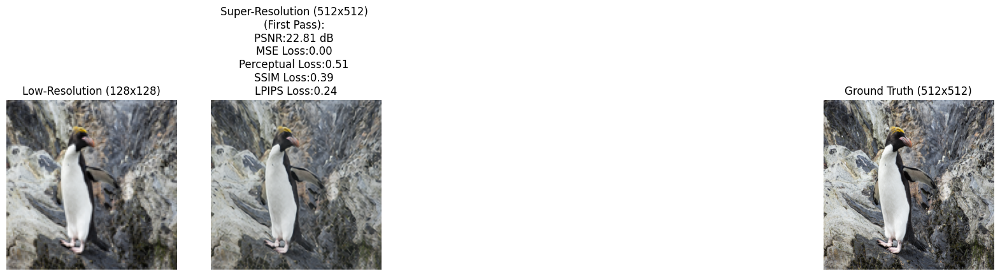

<Figure size 640x480 with 0 Axes>

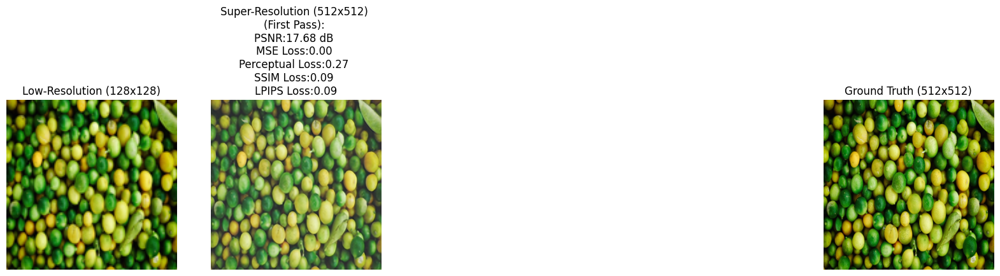

<Figure size 640x480 with 0 Axes>

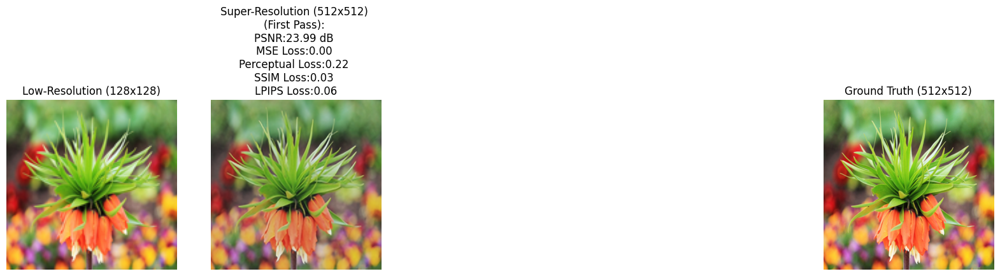

<Figure size 640x480 with 0 Axes>

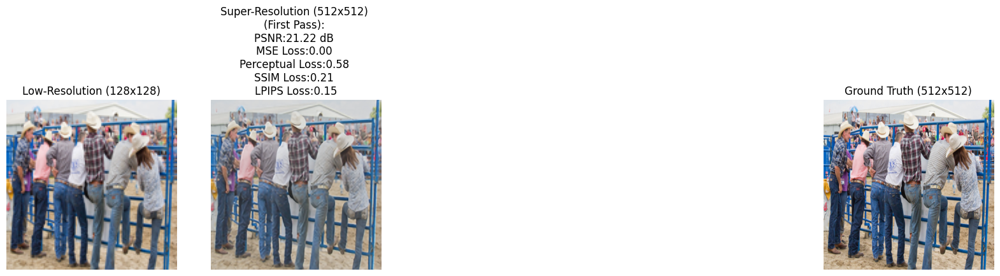

<Figure size 640x480 with 0 Axes>

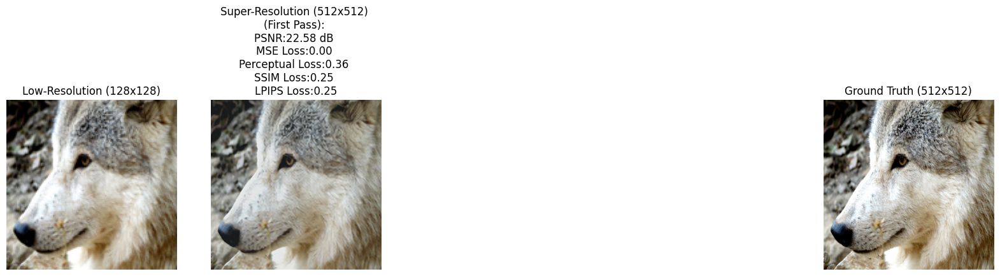

<Figure size 640x480 with 0 Axes>

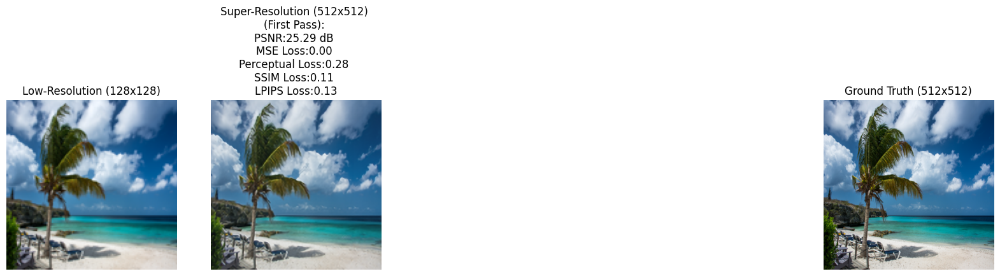

<Figure size 640x480 with 0 Axes>

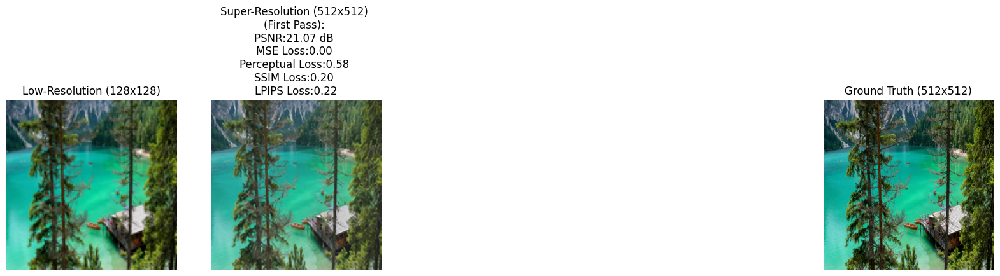

<Figure size 640x480 with 0 Axes>

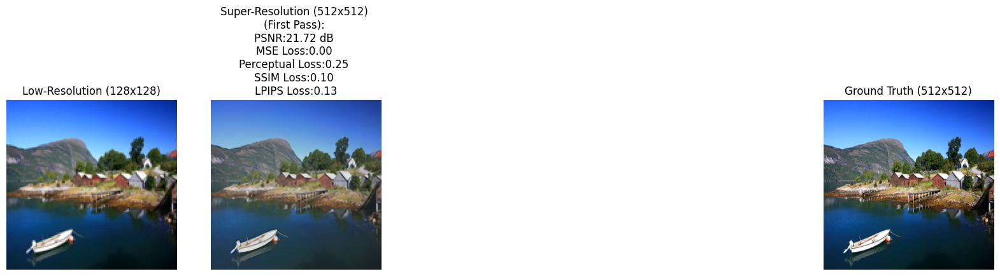

<Figure size 640x480 with 0 Axes>

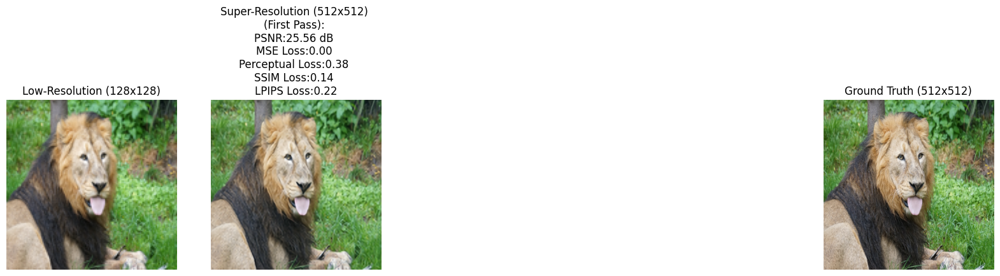

<Figure size 640x480 with 0 Axes>

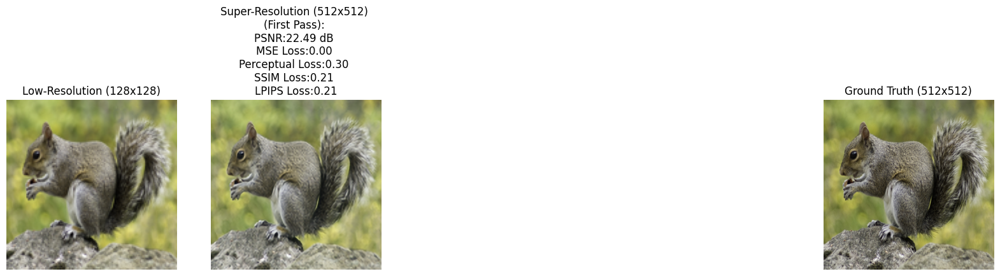

<Figure size 640x480 with 0 Axes>

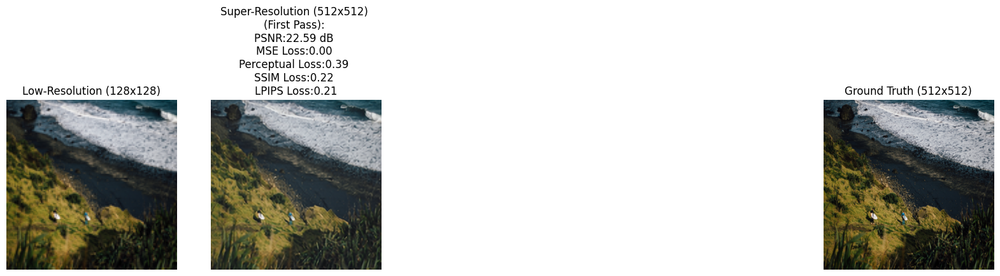

<Figure size 640x480 with 0 Axes>

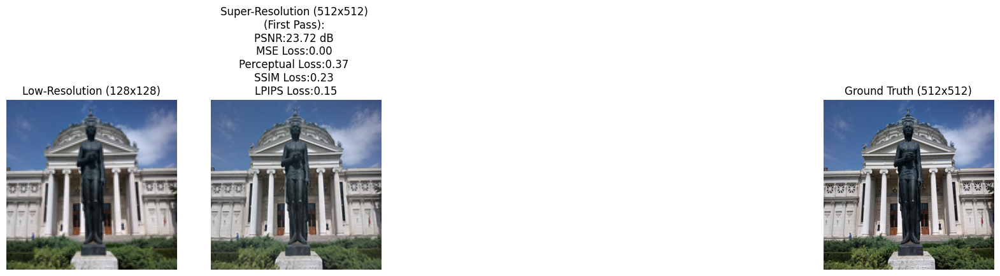

<Figure size 640x480 with 0 Axes>

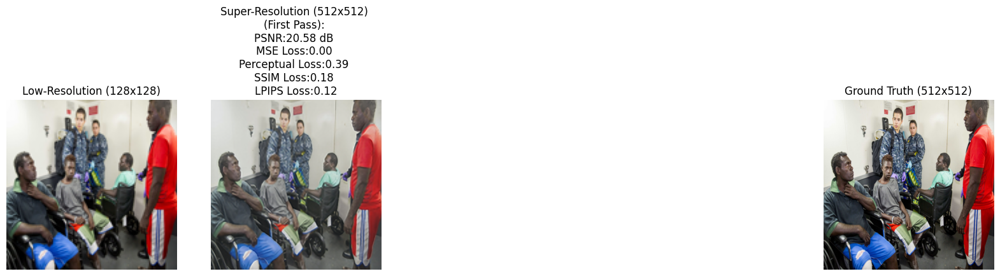


RESULT FROM TEST SET:
------------------------------------------------------------------------------------------------
Average after First Pass:
  PSNR           : 22.22 dB
  MSE Loss       : 0.0035
  Perceptual Loss: 0.4490
  SSIM Loss      : 0.1911
  LPIPS Loss     : 0.1678
----------------------------------
  TOTAL LOSS     : 0.8114
Testing time elapsed:  2.5 mins


In [25]:
start_time = time.time()
WEIGHT_PTH = 'generator_weight_3-steps-All-loss_80_epochs.pth'
generator = EnhanceNet_3step().to(device)
generator.load_state_dict(torch.load(WEIGHT_PTH))
test_model(generator, None, test_data_loader, "ENet Base (ENet-2US)", device)  
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Testing time elapsed: {elapsed_time: .1f} mins')

### ENet Base with MSE Loss Only (ENet-E)

In [20]:
WEIGHT_PTH = 'generator_weight_original_mse_only_6_epochs.pth'
NUM_EPOCH = 6
start_time = time.time()
generator = EnhanceNet().to(device)
training_original_EnhanceNet(generator, train_data_loader, val_data_loader, WEIGHT_PTH, (1, 0, 0, 0), NUM_EPOCH)      
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Training time elapsed: {elapsed_time: .1f} mins')

C:\Users\soota\.conda\envs\Python3_11\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\soota\.conda\envs\Python3_11\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\soota\.conda\envs\Python3_11\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.

Epoch [1/6], MSE Loss: 0.0044; Perceptual Loss: 0.6061; SSIM Loss: 0.1727; LPIPS Loss: 0.3334; Validation set Total Loss: 1.0541
 => Saving best weights for Generator at Epoch 1.
Epoch [2/6], MSE Loss: 0.0044; Perceptual Loss: 0.6061; SSIM Loss: 0.1714; LPIPS Loss: 0.3334; Validation set Total Loss: 1.0539
 => Saving best weights for Generator at Epoch 2.
Epoch [3/6], MSE Loss: 0.0044; Perceptual Loss: 0.6061; SSIM Loss: 0.1714; LPIPS Loss: 0.3334; Validation set Total Loss: 1.0538
 => Saving best weights for Generator at Epoch 3.
Epoch [4/6], MSE Loss: 0.0044; Perceptual Loss: 0.6061; SSIM Loss: 0.1714; LPIPS Loss: 0.3333; Validation set Total Loss: 1.0539
Epoch [5/6], MSE Loss: 0.0044; Perceptual Loss: 0.6062; SSIM Loss: 0.1714; LPIPS Loss: 0.3333; Validation set Total Loss: 1.0540
Epoch [6/6], MSE Loss: 0.0044; Perceptual Loss: 0.6062; SSIM Loss: 0.1714; LPIPS Loss: 0.3333; Validation set Total Loss: 1.0533
 => Saving best weights for Generator at Epoch 6.
Training time elapsed:  24

#### Result for ENet Base with MSE Loss Only (ENet-E)

<Figure size 640x480 with 0 Axes>

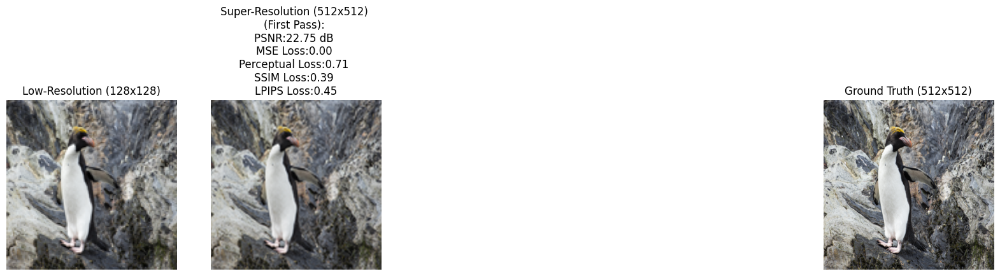

<Figure size 640x480 with 0 Axes>

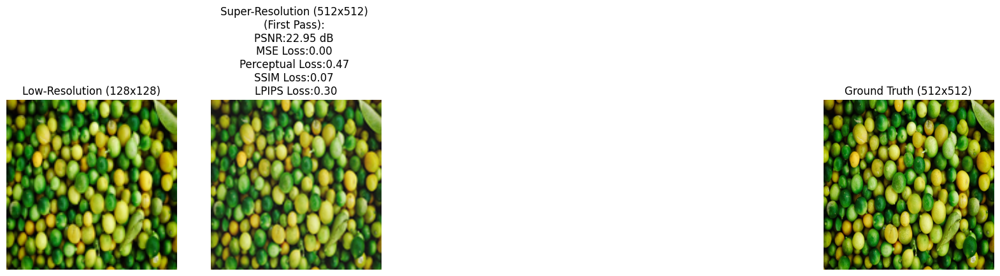

<Figure size 640x480 with 0 Axes>

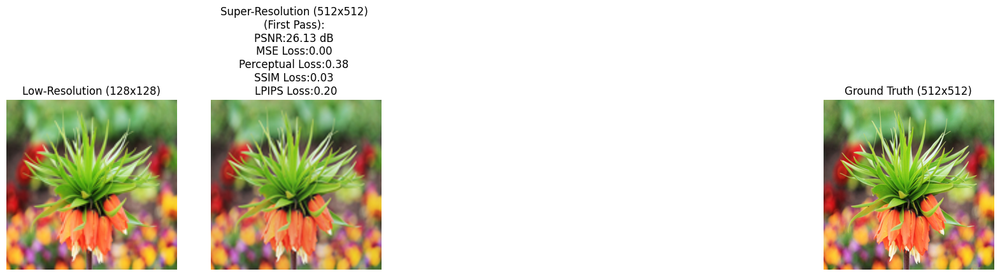

<Figure size 640x480 with 0 Axes>

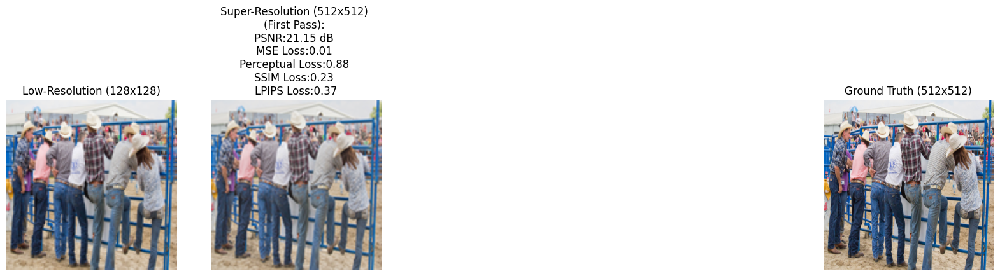

<Figure size 640x480 with 0 Axes>

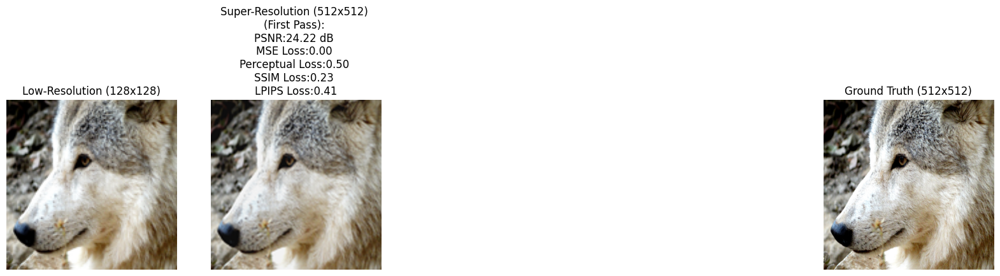

<Figure size 640x480 with 0 Axes>

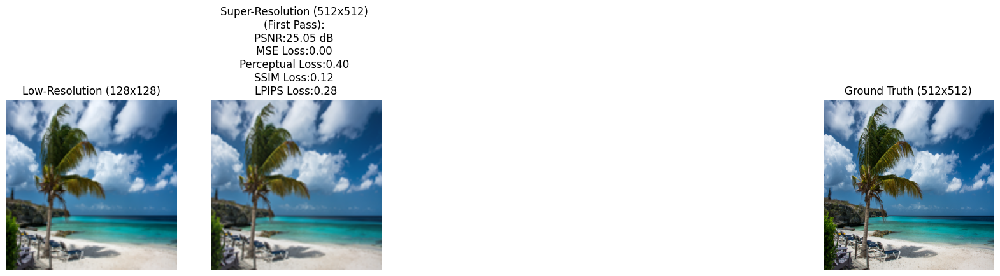

<Figure size 640x480 with 0 Axes>

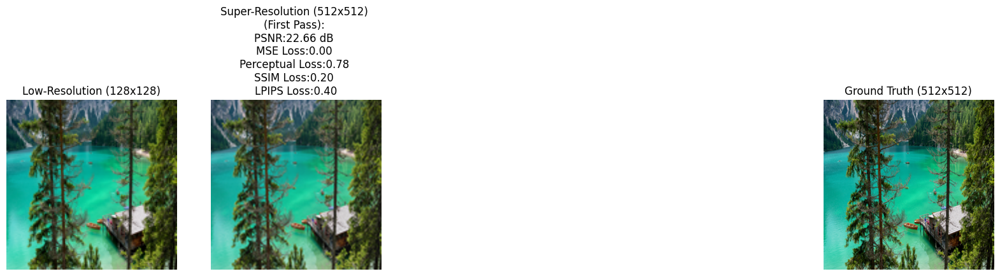

<Figure size 640x480 with 0 Axes>

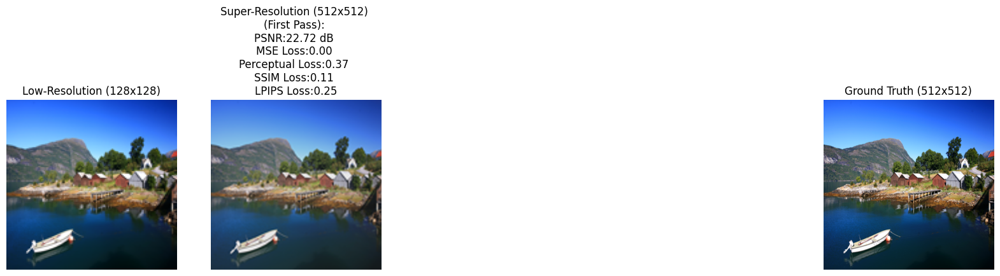

<Figure size 640x480 with 0 Axes>

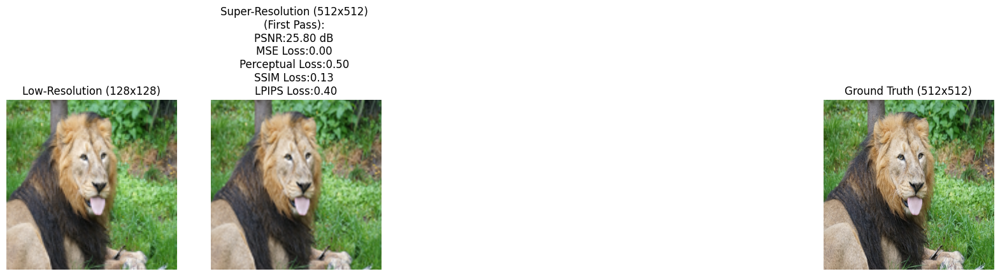

<Figure size 640x480 with 0 Axes>

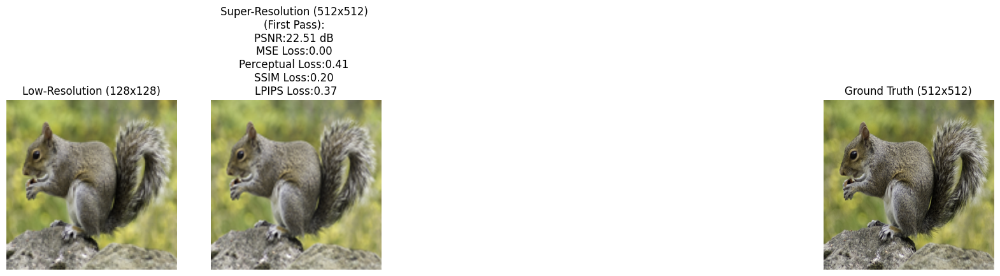

<Figure size 640x480 with 0 Axes>

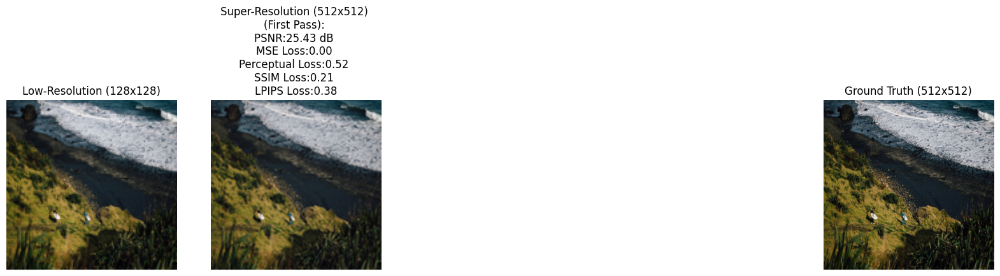

<Figure size 640x480 with 0 Axes>

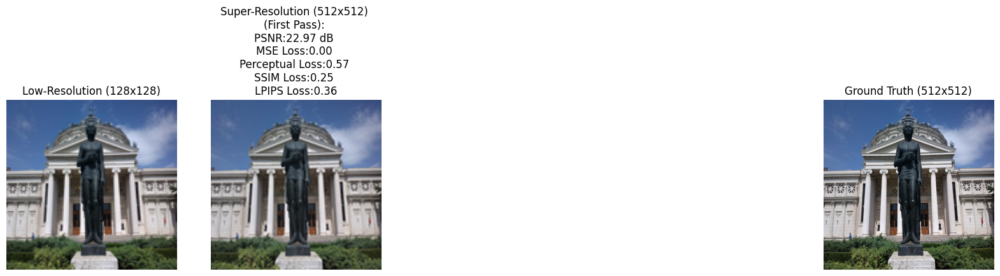

<Figure size 640x480 with 0 Axes>

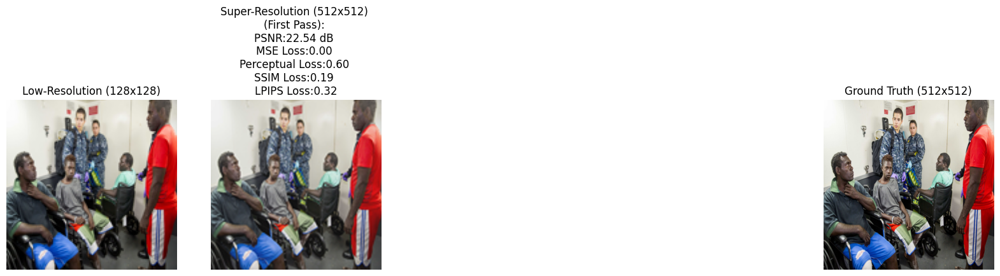


RESULT FROM TEST SET:
------------------------------------------------------------------------------------------------
Average after First Pass:
  PSNR           : 22.68 dB
  MSE Loss       : 0.0046
  Perceptual Loss: 0.6410
  SSIM Loss      : 0.1908
  LPIPS Loss     : 0.3424
----------------------------------
  TOTAL LOSS     : 1.1787
Testing time elapsed:  1.9 mins


In [27]:
start_time = time.time()
WEIGHT_PTH = 'generator_weight_original_mse_only_6_epochs.pth'
generator = EnhanceNet().to(device)
generator.load_state_dict(torch.load(WEIGHT_PTH))
test_model(generator, None, test_data_loader, "ENet Base with MSE Loss Only", device)  
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Testing time elapsed: {elapsed_time: .1f} mins')

### ENet Base with 0.2MSE + Perceptual + SSIM + LPIPS Losses (ENet-4L)

In [22]:
WEIGHT_PTH = 'generator_weight_original_0.2mse_perceptual_ssim_lpips_60_epochs.pth'
NUM_EPOCH = 60
start_time = time.time()
generator = EnhanceNet().to(device)
training_original_EnhanceNet(generator, train_data_loader, val_data_loader, WEIGHT_PTH, (0.2, 1, 1, 1), NUM_EPOCH)   
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Training time elapsed: {elapsed_time: .1f} mins')

Epoch [1/60], MSE Loss: 0.0056; Perceptual Loss: 0.6053; SSIM Loss: 0.3261; LPIPS Loss: 0.3425; Validation set Total Loss: 1.2427
 => Saving best weights for Generator at Epoch 1.
Epoch [2/60], MSE Loss: 0.0058; Perceptual Loss: 0.6051; SSIM Loss: 0.3426; LPIPS Loss: 0.3436; Validation set Total Loss: 1.2864
Epoch [3/60], MSE Loss: 0.0059; Perceptual Loss: 0.6049; SSIM Loss: 0.3447; LPIPS Loss: 0.3442; Validation set Total Loss: 1.3208
Epoch [4/60], MSE Loss: 0.0058; Perceptual Loss: 0.6038; SSIM Loss: 0.3335; LPIPS Loss: 0.3395; Validation set Total Loss: 1.0999
 => Saving best weights for Generator at Epoch 4.
Epoch [5/60], MSE Loss: 0.0048; Perceptual Loss: 0.5667; SSIM Loss: 0.2108; LPIPS Loss: 0.2839; Validation set Total Loss: 0.9744
 => Saving best weights for Generator at Epoch 5.
Epoch [6/60], MSE Loss: 0.0044; Perceptual Loss: 0.5440; SSIM Loss: 0.1871; LPIPS Loss: 0.2353; Validation set Total Loss: 0.8960
 => Saving best weights for Generator at Epoch 6.
Epoch [7/60], MSE Lo

#### Result of ENet Base with 0.2MSE + Perceptual + SSIM + LPIPS Losses (ENet-4L)

<Figure size 640x480 with 0 Axes>

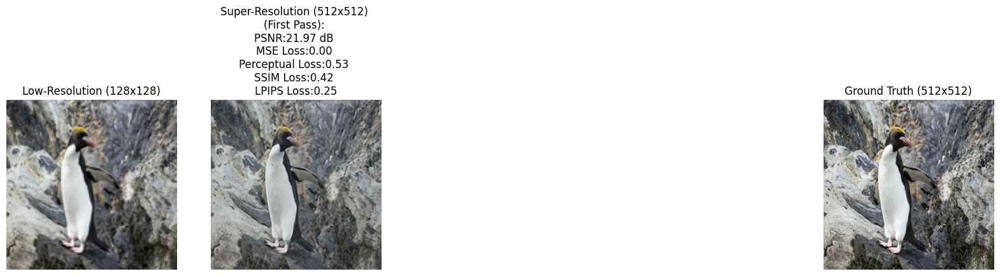

<Figure size 640x480 with 0 Axes>

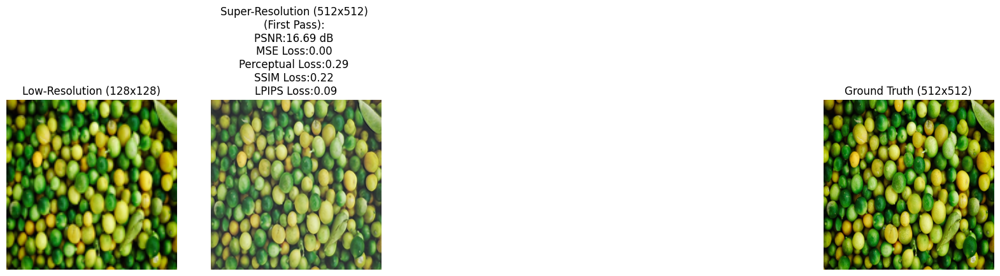

<Figure size 640x480 with 0 Axes>

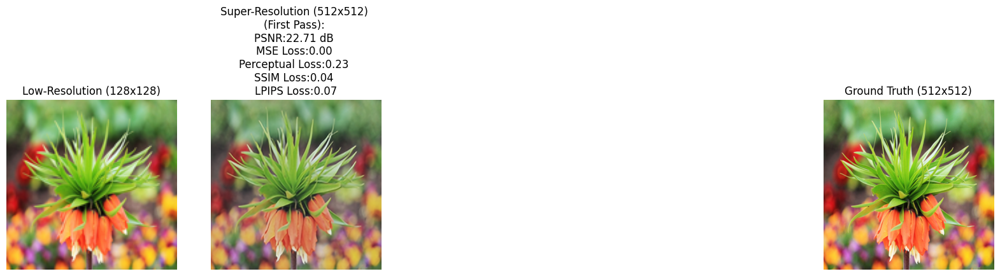

<Figure size 640x480 with 0 Axes>

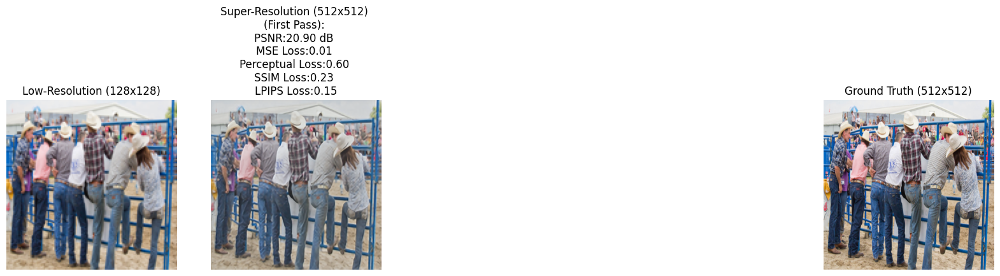

<Figure size 640x480 with 0 Axes>

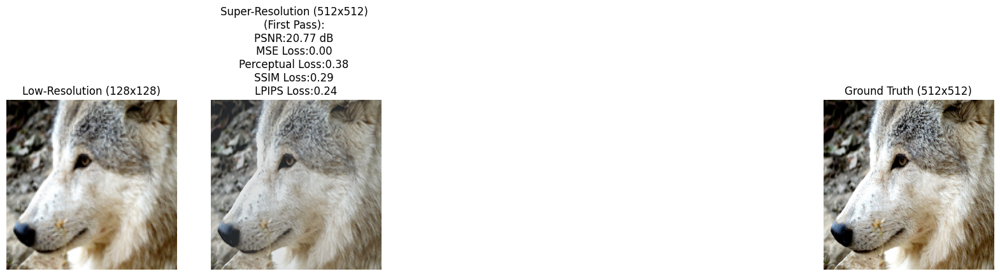

<Figure size 640x480 with 0 Axes>

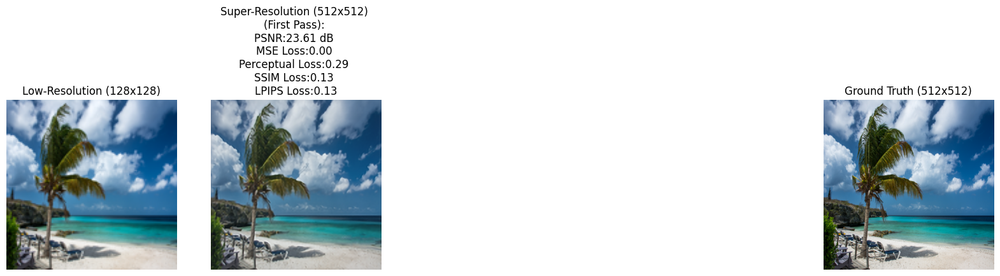

<Figure size 640x480 with 0 Axes>

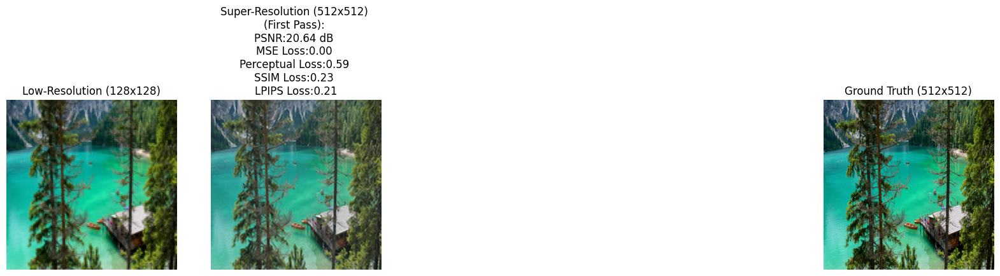

<Figure size 640x480 with 0 Axes>

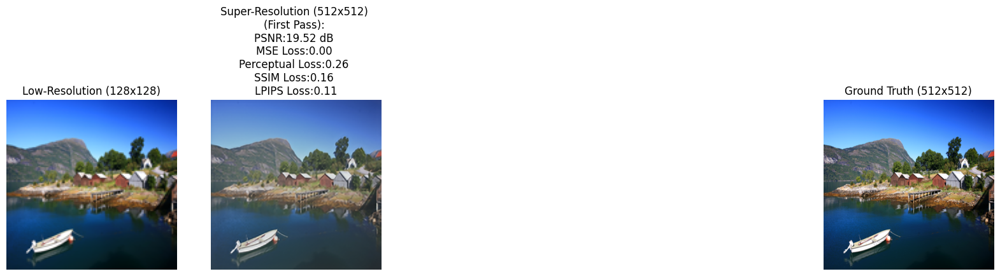

<Figure size 640x480 with 0 Axes>

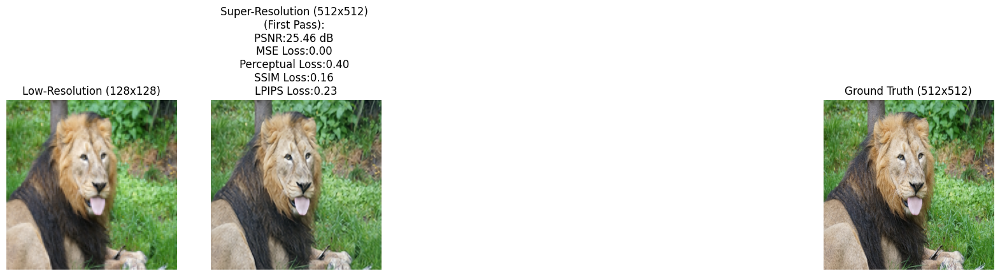

<Figure size 640x480 with 0 Axes>

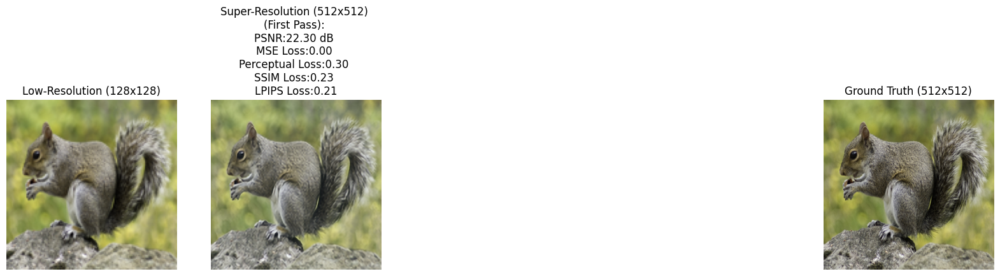

<Figure size 640x480 with 0 Axes>

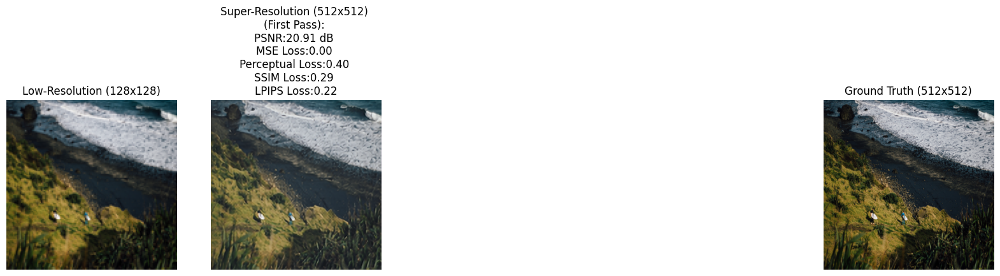

<Figure size 640x480 with 0 Axes>

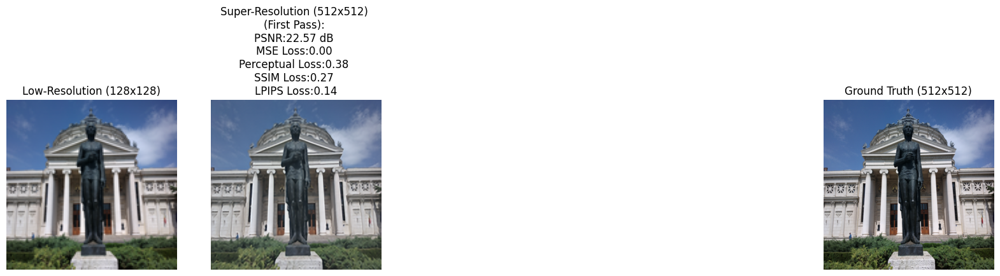

<Figure size 640x480 with 0 Axes>

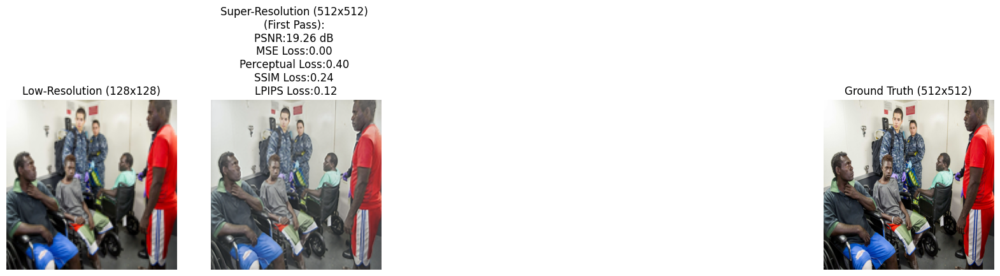


RESULT FROM TEST SET:
------------------------------------------------------------------------------------------------
Average after First Pass:
  PSNR           : 21.11 dB
  MSE Loss       : 0.0047
  Perceptual Loss: 0.4601
  SSIM Loss      : 0.2495
  LPIPS Loss     : 0.1616
----------------------------------
  TOTAL LOSS     : 0.8759
Testing time elapsed:  1.9 mins


In [28]:
start_time = time.time()
WEIGHT_PTH = 'generator_weight_original_0.2mse_perceptual_ssim_lpips_60_epochs.pth'
generator = EnhanceNet().to(device)
generator.load_state_dict(torch.load(WEIGHT_PTH))
test_model(generator, None, test_data_loader, "ENet Base with 0.2MSE + Perceptual + SSIM + LPIPS Losses", device)  
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Testing time elapsed: {elapsed_time: .1f} mins')

### ENet-2ST

In [23]:
loss_factor1 = (0.2,1.0,1.0,1.0)
loss_factor2 = (0.2,1.0,1.0,1.0)
NUM_EPOCH1 = 40
NUM_EPOCH2 = 30
weight_pth1 = "generator1_" + str(loss_factor1) + "_40_epochs.pth"
weight_pth2 = "generator2_" + str(loss_factor2) + "_30_epochs.pth"
start_time = time.time()
generator1 = EnhanceNet_mod().to(device)
generator2 = EnhanceNet_mod().to(device)
training_two_stage_EnhanceNet(generator1, generator2, train_data_loader, val_data_loader, weight_pth1, weight_pth2, loss_factor1, loss_factor2, train_generator1=True, num_epochs1=NUM_EPOCH1, num_epochs2=NUM_EPOCH2)
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Training time elapsed: {elapsed_time: .1f} mins')

Epoch [1/40], Generator 1 - MSE Loss: 0.0026; Perceptual Loss: 0.4261; SSIM Loss: 0.1266; LPIPS Loss: 0.1914; Validation set Total Loss: 0.5381
 => Saving best weights for Generator 1 at Epoch 1.
Epoch [2/40], Generator 1 - MSE Loss: 0.0026; Perceptual Loss: 0.4257; SSIM Loss: 0.1227; LPIPS Loss: 0.1909; Validation set Total Loss: 0.5293
 => Saving best weights for Generator 1 at Epoch 2.
Epoch [3/40], Generator 1 - MSE Loss: 0.0026; Perceptual Loss: 0.4258; SSIM Loss: 0.1221; LPIPS Loss: 0.1908; Validation set Total Loss: 0.5313
Epoch [4/40], Generator 1 - MSE Loss: 0.0026; Perceptual Loss: 0.4254; SSIM Loss: 0.1237; LPIPS Loss: 0.1908; Validation set Total Loss: 0.5363
Epoch [5/40], Generator 1 - MSE Loss: 0.0033; Perceptual Loss: 0.4027; SSIM Loss: 0.1463; LPIPS Loss: 0.1679; Validation set Total Loss: 0.5198
 => Saving best weights for Generator 1 at Epoch 5.
Epoch [6/40], Generator 1 - MSE Loss: 0.0035; Perceptual Loss: 0.3696; SSIM Loss: 0.1570; LPIPS Loss: 0.1377; Validation set

#### Result of ENet-2ST

<Figure size 640x480 with 0 Axes>

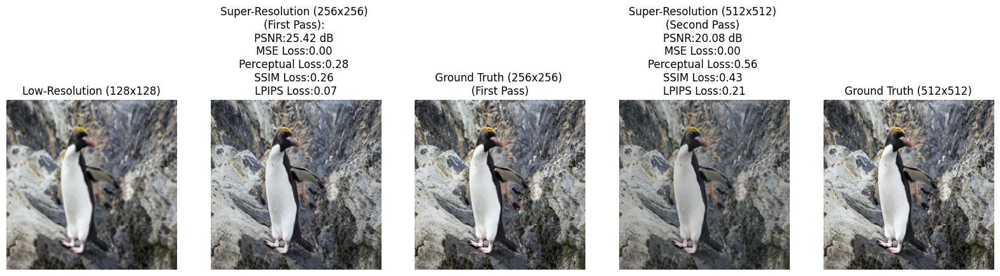

<Figure size 640x480 with 0 Axes>

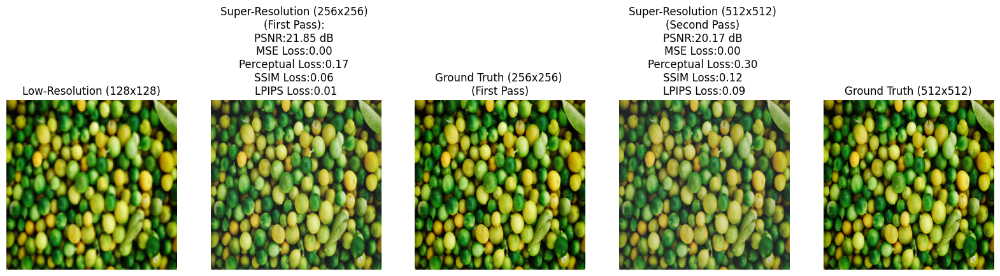

<Figure size 640x480 with 0 Axes>

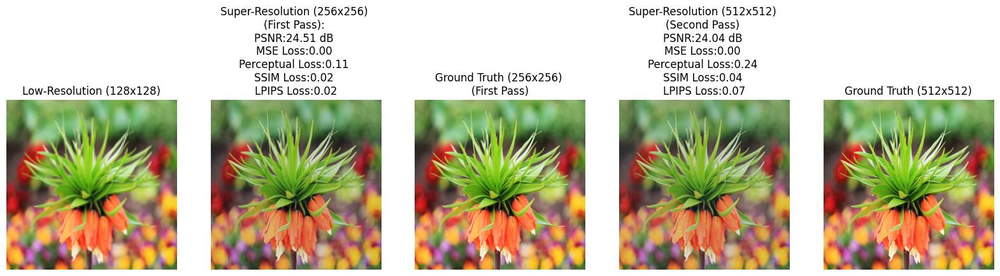

<Figure size 640x480 with 0 Axes>

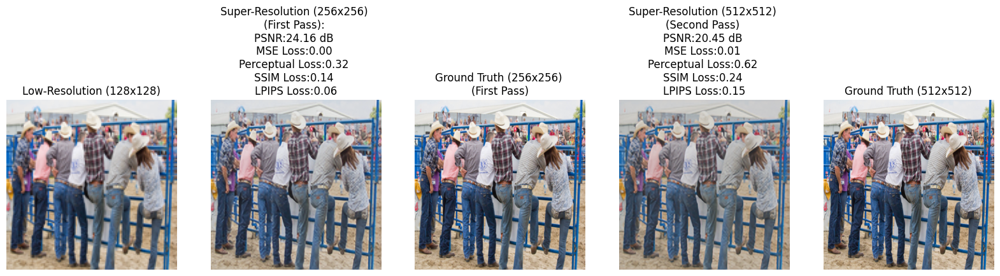

<Figure size 640x480 with 0 Axes>

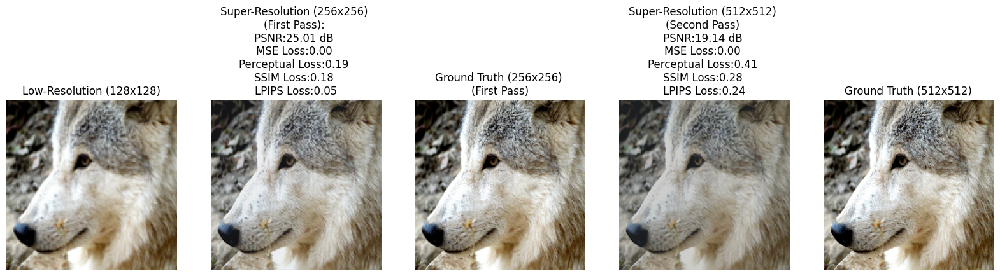

<Figure size 640x480 with 0 Axes>

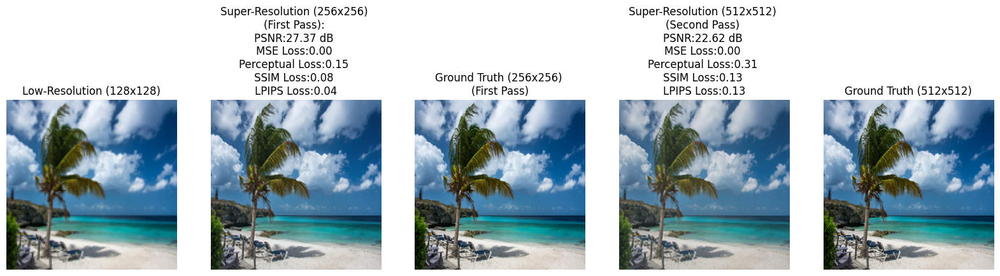

<Figure size 640x480 with 0 Axes>

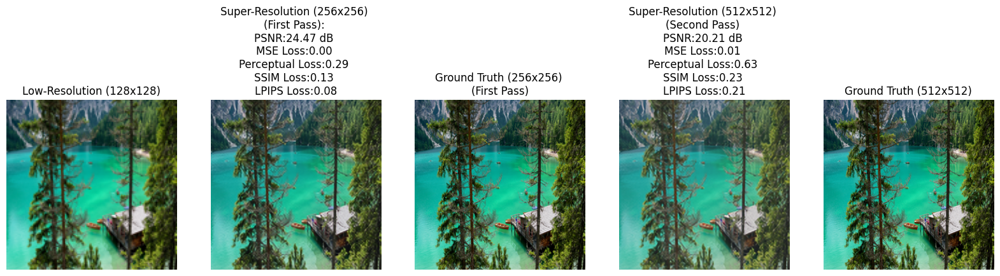

<Figure size 640x480 with 0 Axes>

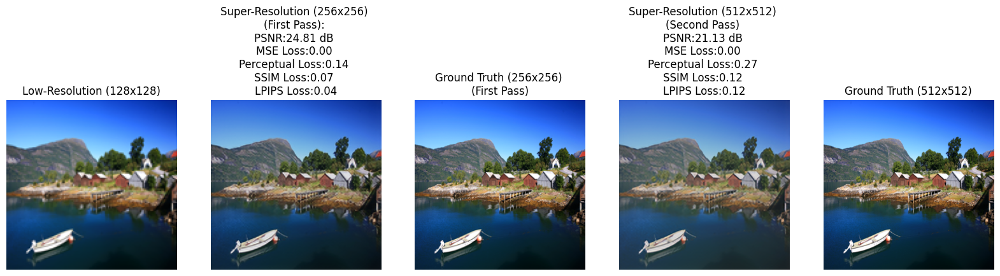

<Figure size 640x480 with 0 Axes>

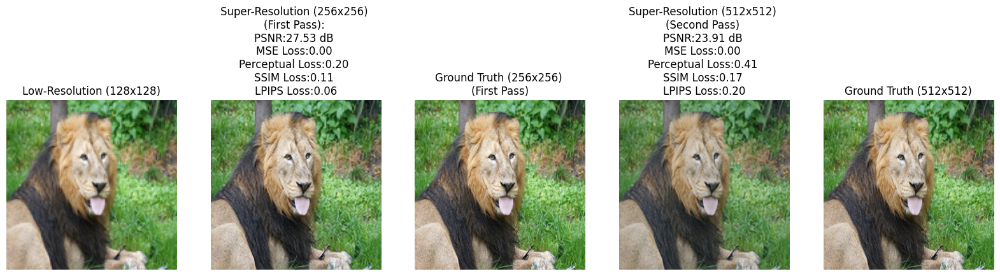

<Figure size 640x480 with 0 Axes>

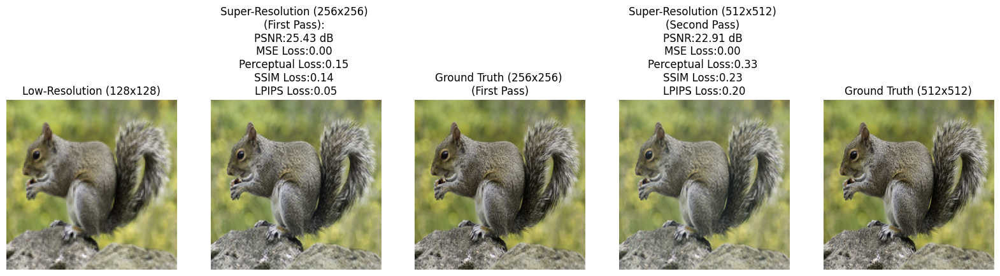

<Figure size 640x480 with 0 Axes>

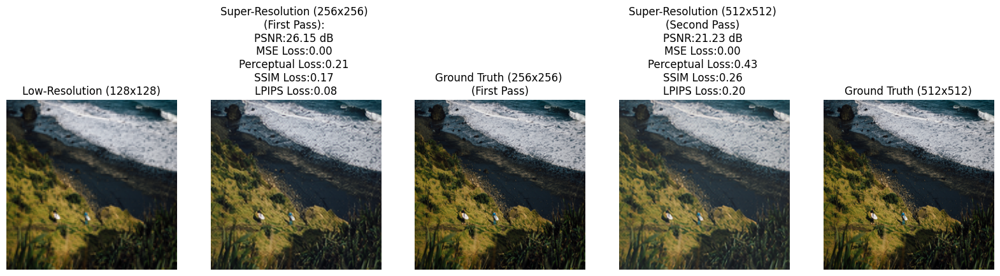

<Figure size 640x480 with 0 Axes>

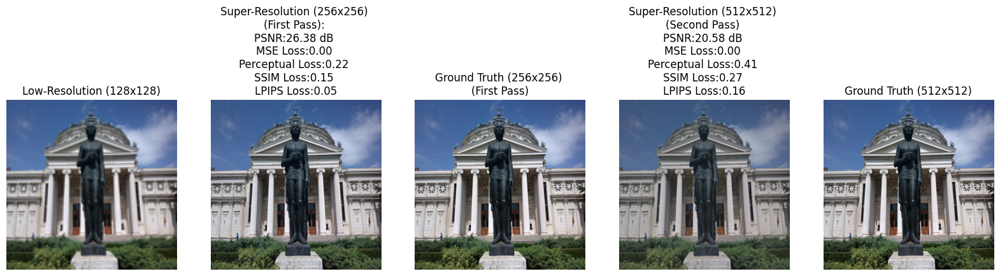

<Figure size 640x480 with 0 Axes>

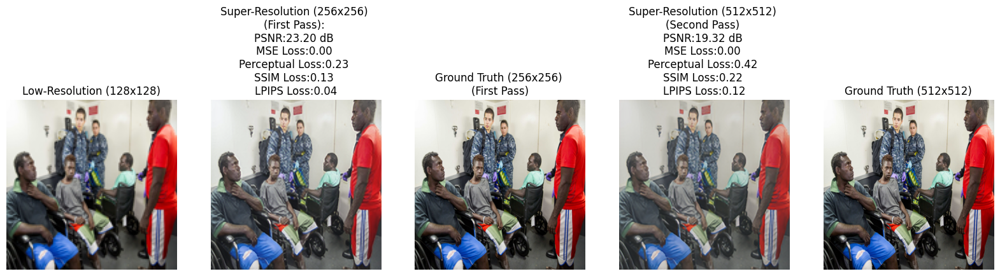


RESULT FROM TEST SET:
------------------------------------------------------------------------------------------------
Average after First Pass:
  PSNR           : 24.82 dB
  MSE Loss       : 0.0023
  Perceptual Loss: 0.2520
  SSIM Loss      : 0.1386
  LPIPS Loss     : 0.0590
----------------------------------
  TOTAL LOSS     : 0.4519
------------------------------------------------------------------------------------------------
Average after Second Pass:
  PSNR           : 20.44 dB
  MSE Loss       : 0.0043
  Perceptual Loss: 0.4874
  SSIM Loss      : 0.2248
  LPIPS Loss     : 0.1657
----------------------------------
  TOTAL LOSS     : 0.8823
Testing time elapsed:  3.3 mins


In [29]:
start_time = time.time()
weight_pth1 = "generator1_" + str(loss_factor1) + "_40_epochs.pth"
weight_pth2 = "generator2_" + str(loss_factor2) + "_30_epochs.pth"
generator1 = EnhanceNet_mod().to(device)
generator1.load_state_dict(torch.load(weight_pth1))
generator2 = EnhanceNet_mod().to(device)
generator2.load_state_dict(torch.load(weight_pth2))
test_model(generator1, generator2, test_data_loader, "Two stage: " + str(loss_factor1) + "; " + str(loss_factor2) + "; 40-30", device)      
end_time = time.time()
elapsed_time = (end_time - start_time)/60
print(f'Testing time elapsed: {elapsed_time: .1f} mins')